In [ ]:
from IPython.display import display, Javascript, Image
def video_stream():
  js = Javascript('''
    var video;
    var div = null;
    var stream;
    var captureCanvas;
    var imgElement;
    var labelElement;
    
    var pendingResolve = null;
    var shutdown = false;
    
    function removeDom() {
       stream.getVideoTracks()[0].stop();
       video.remove();
       div.remove();
       video = null;
       div = null;
       stream = null;
       imgElement = null;
       captureCanvas = null;
       labelElement = null;
    }
    
    function onAnimationFrame() {
      if (!shutdown) {
        window.requestAnimationFrame(onAnimationFrame);
      }
      if (pendingResolve) {
        var result = "";
        if (!shutdown) {
          captureCanvas.getContext('2d').drawImage(video, 0, 0, 640, 480);
          result = captureCanvas.toDataURL('image/jpeg', 0.8)
        }
        var lp = pendingResolve;
        pendingResolve = null;
        lp(result);
      }
    }
    
    async function createDom() {
      if (div !== null) {
        return stream;
      }

      div = document.createElement('div');
      div.style.border = '2px solid black';
      div.style.padding = '3px';
      div.style.width = '100%';
      div.style.maxWidth = '600px';
      document.body.appendChild(div);
      
      const modelOut = document.createElement('div');
      modelOut.innerHTML = "<span>Status:</span>";
      labelElement = document.createElement('span');
      labelElement.innerText = 'No data';
      labelElement.style.fontWeight = 'bold';
      modelOut.appendChild(labelElement);
      div.appendChild(modelOut);
           
      video = document.createElement('video');
      video.style.display = 'block';
      video.width = div.clientWidth - 6;
      video.setAttribute('playsinline', '');
      video.onclick = () => { shutdown = true; };
      stream = await navigator.mediaDevices.getUserMedia(
          {video: { facingMode: "environment"}});
      div.appendChild(video);

      imgElement = document.createElement('img');
      imgElement.style.position = 'absolute';
      imgElement.style.zIndex = 1;
      imgElement.onclick = () => { shutdown = true; };
      div.appendChild(imgElement);
      
      const instruction = document.createElement('div');
      instruction.innerHTML = 
          '<span style="color: red; font-weight: bold;">' +
          'Bấm vào video để dừng</span>';
      div.appendChild(instruction);
      instruction.onclick = () => { shutdown = true; };
      
      video.srcObject = stream;
      await video.play();

      captureCanvas = document.createElement('canvas');
      captureCanvas.width = 640; //video.videoWidth;
      captureCanvas.height = 480; //video.videoHeight;
      window.requestAnimationFrame(onAnimationFrame);
      
      return stream;
    }
    async function stream_frame(label, imgData) {
      if (shutdown) {
        removeDom();
        shutdown = false;
        return '';
      }

      var preCreate = Date.now();
      stream = await createDom();
      
      var preShow = Date.now();
      if (label != "") {
        labelElement.innerHTML = label;
      }
            
      if (imgData != "") {
        var videoRect = video.getClientRects()[0];
        imgElement.style.top = videoRect.top + "px";
        imgElement.style.left = videoRect.left + "px";
        imgElement.style.width = videoRect.width + "px";
        imgElement.style.height = videoRect.height + "px";
        imgElement.src = imgData;
      }
      
      var preCapture = Date.now();
      var result = await new Promise(function(resolve, reject) {
        pendingResolve = resolve;
      });
      shutdown = false;
      
      return {'create': preShow - preCreate, 
              'show': preCapture - preShow, 
              'capture': Date.now() - preCapture,
              'img': result};
    }
    ''')

  display(js)
  
def video_frame(label, bbox):
  data = eval_js('stream_frame("{}", "{}")'.format(label, bbox))
  return data

In [ ]:
# function to convert the JavaScript object into an OpenCV image
def js_to_image(js_reply):
  """
  Params:
          js_reply: JavaScript object containing image from webcam
  Returns:
          img: OpenCV BGR image
  """
  # decode base64 image
  image_bytes = b64decode(js_reply.split(',')[1])
  # convert bytes to numpy array
  jpg_as_np = np.frombuffer(image_bytes, dtype=np.uint8)
  # decode numpy array into OpenCV BGR image
  img = cv2.imdecode(jpg_as_np, flags=1)

  return img

# function to convert OpenCV Rectangle bounding box image into base64 byte string to be overlayed on video stream
def bbox_to_bytes(bbox_array):
  """
  Params:
          bbox_array: Numpy array (pixels) containing rectangle to overlay on video stream.
  Returns:
        bytes: Base64 image byte string
  """
  # convert array into PIL image
  bbox_PIL = PIL.Image.fromarray(bbox_array, 'RGBA')
  iobuf = io.BytesIO()
  # format bbox into png for return
  bbox_PIL.save(iobuf, format='png')
  # format return string
  bbox_bytes = 'data:image/png;base64,{}'.format((str(b64encode(iobuf.getvalue()), 'utf-8')))

  return bbox_bytes

In [ ]:
%cd /content
from google.colab.output import eval_js
from google.colab.patches import cv2_imshow
from base64 import b64decode, b64encode
import numpy as np
import PIL
import io
import cv2
from keras.models import  load_model
from tensorflow.keras.utils import load_img, img_to_array
# start streaming video from webcam
video_stream()
# label for video
label_html = 'Đang lấy hình ảnh...'
# initialze bounding box to empty
bbox = ''
count = 0 

# Load model Nhận diện gaogao
model_file_path = "/content/rice.h5"
vggmodel = load_model(model_file_path)

predict = ['Gao lut',
           'Gao Huyet Rong',
           'Gao Lai Sua',
           'Gao Long Lai',
           'Gao Lut Bac',
           'Gao lut Dien Bien',
           ' Gao Lut Do',
           'Gao Lut Trang',
           'Gao Nep Cam',
           'Gao Nep Sap',
           'Gao Ngoc Troi',
           'Gao Tam',
           'Gao Tam Thom',
           'gao Thom Go Cong'
           'Gao Thom My']

while True:
    # Đọc ảnh trả về từ JS
    label_html = 'Đang lấy hình ảnh...'
    js_reply = video_frame(label_html, bbox)
    if not js_reply:
        break

    # convert JS response to OpenCV Image
    frame = js_to_image(js_reply["img"])

    # Resize để đưa vào model
    frame_p = cv2.resize(frame, dsize=(250,250))
    tensor = np.expand_dims(frame_p, axis=0)

    # Feed vào mạng

    pred = vggmodel.predict(tensor)
    class_id = np.argmax(pred)
    class_name = predict[class_id]


   
    #pred = vggmodel.predict(tensor)
    #class_id = np.argmax(pred)
    #class_name = classes[class_id]

    # Vẽ lên một ảnh để tẹo nữa overlay

    # create transparent overlay for bounding box
    bbox_array = np.zeros([480,640,4], dtype=np.uint8)
   
    bbox_array = cv2.putText(bbox_array, "{}".format(class_name),
                        (10, 20), cv2.FONT_HERSHEY_SIMPLEX, 0.5,
                        (0, 255,0), 2)

    bbox_array[:,:,3] = (bbox_array.max(axis = 2) > 0 ).astype(int) * 255
    # convert overlay of bbox into bytes
    bbox_bytes = bbox_to_bytes(bbox_array)
    # update bbox so next frame gets new overlay
    bbox = bbox_bytes

    

/content


<IPython.core.display.Javascript object>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
import cv2
import numpy as np
import pandas as pd
import seaborn as ses
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import precision_score,recall_score,confusion_matrix,classification_report,accuracy_score,f1_score


from keras.layers import Dense, Activation, Dropout, BatchNormalization, LSTM,Conv2D, MaxPooling2D, Flatten
from keras.models import Sequential
from keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import to_categorical ,load_img, img_to_array
from tensorflow.keras.optimizers import RMSprop,SGD
from tensorflow.keras.models import load_model
from keras import callbacks
from keras.callbacks import EarlyStopping,ReduceLROnPlateau

import random
import os

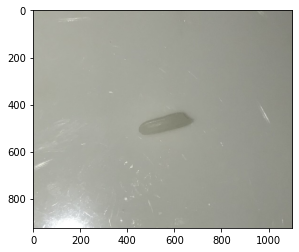

Day la gao thom go cong


In [ ]:
filename = '/content/drive/MyDrive/AIrice/Train/Laisua/IMG_2204.jpeg'

img = mpimg.imread(filename)
imgplot = plt.imshow(img)
plt.show()

img = load_img(filename,target_size = (250,250))
img = img_to_array(img)
img =  img.reshape(1,250,250,3)
img = img.astype('float32')
img = img/255
kq = np.argmax(vggmodel.predict(img),axis= -1)

if kq==0:
  print('Day la gao lut than')
elif kq ==1:
  print('Day la gao huyet rong')
elif kq ==2:
  print('Day la gao lai sua')
elif kq ==3:
  print('Day la gao long lai')
elif kq ==4:
  print('Day la gao lut bac')
elif kq ==5:
  print('Day la gao lut dien bien')
elif kq ==6:
  print('Day la gao lut do')
elif kq ==7:
  print('Day la gao lut trang')
elif kq ==8:
  print('Day la gao nep cam')
elif kq ==9:
  print('Day la gao nep sap')
elif kq ==10:
  print('Day la gao ngoc troi')
elif kq ==11:
  print('Day la gao tam')
elif kq ==12:
  print('Day la gao tam thom')
elif kq ==13:
  print('Day la gao thom my')
elif kq ==14:
  print('Day la gao thom go cong')

Creating..../data/frame0.jpg


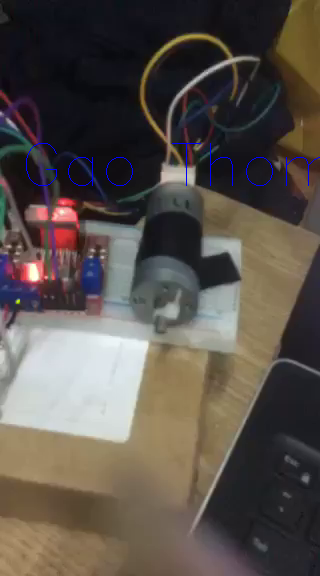

Gao Thom Go Cong
Creating..../data/frame1.jpg


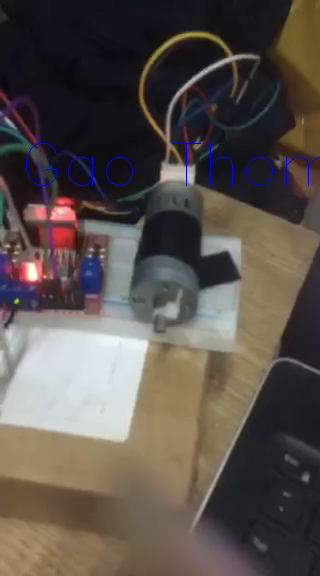

Gao Thom Go Cong
Creating..../data/frame2.jpg


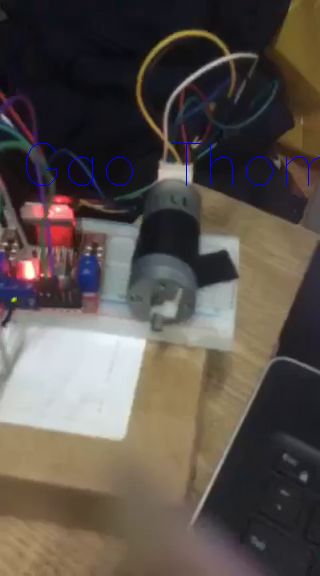

Gao Thom Go Cong
Creating..../data/frame3.jpg


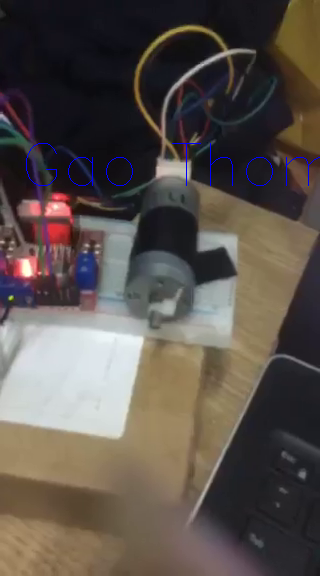

Gao Thom Go Cong
Creating..../data/frame4.jpg


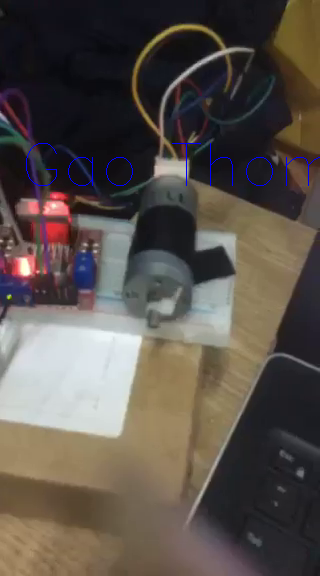

Gao Thom Go Cong
Creating..../data/frame5.jpg


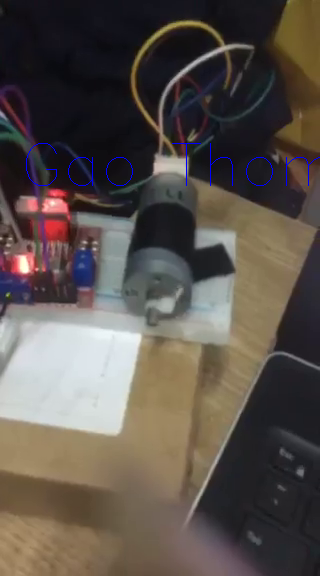

Gao Thom Go Cong
Creating..../data/frame6.jpg


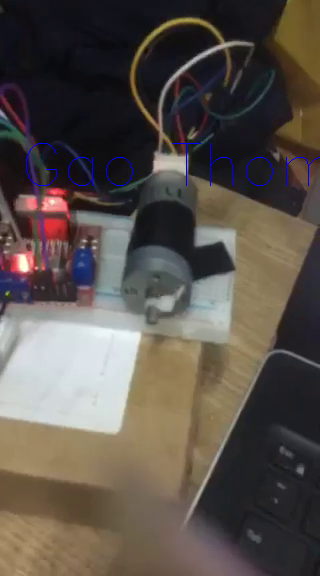

Gao Thom Go Cong
Creating..../data/frame7.jpg


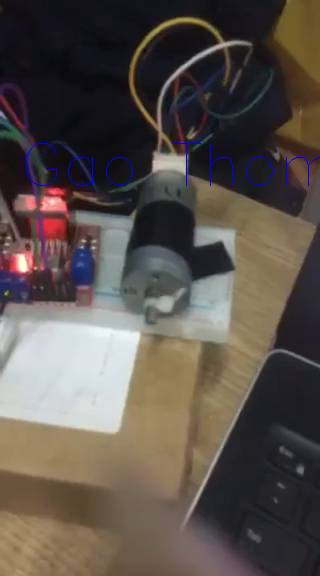

Gao Thom Go Cong
Creating..../data/frame8.jpg


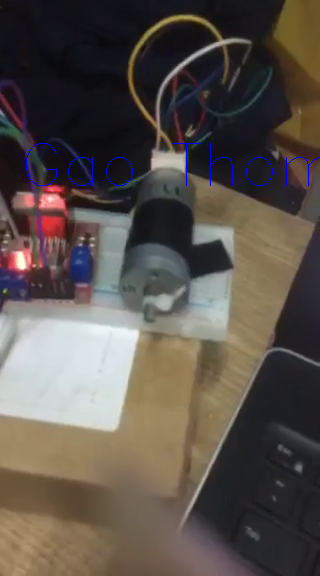

Gao Thom Go Cong
Creating..../data/frame9.jpg


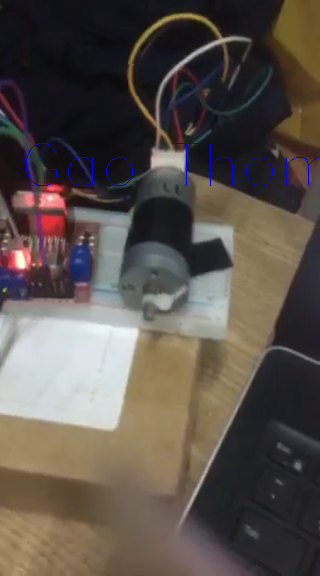

Gao Thom Go Cong
Creating..../data/frame10.jpg


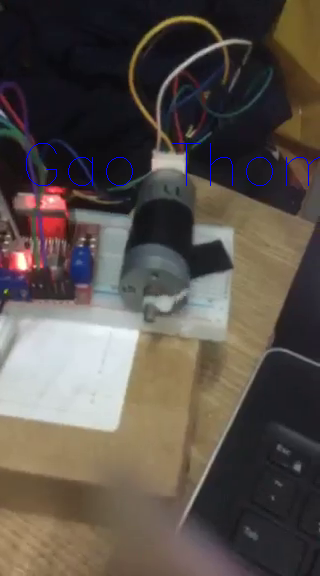

Gao Thom Go Cong
Creating..../data/frame11.jpg


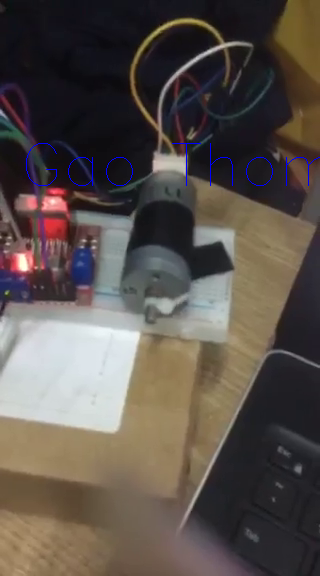

Gao Thom Go Cong
Creating..../data/frame12.jpg


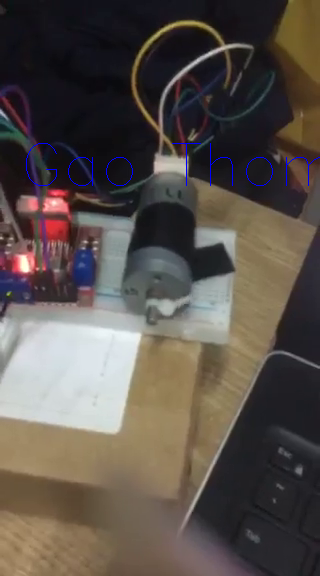

Gao Thom Go Cong
Creating..../data/frame13.jpg


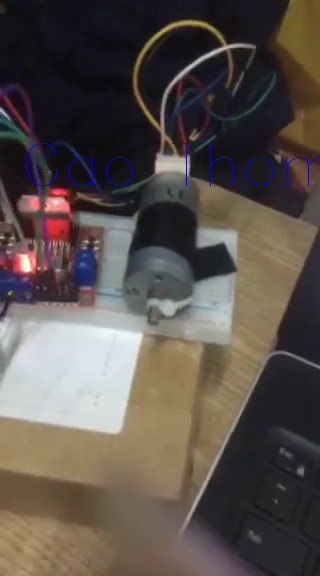

Gao Thom Go Cong
Creating..../data/frame14.jpg


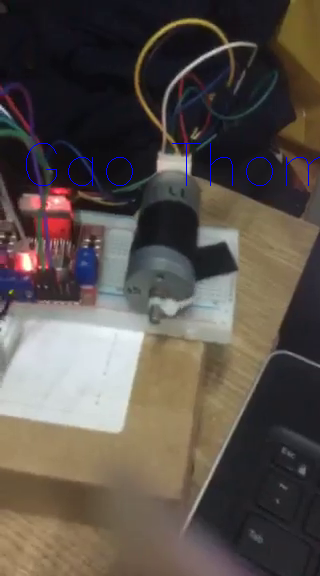

Gao Thom Go Cong
Creating..../data/frame15.jpg


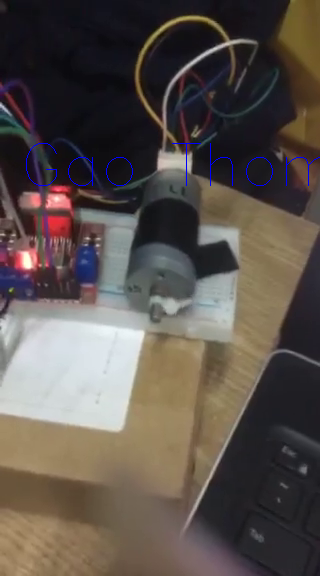

Gao Thom Go Cong
Creating..../data/frame16.jpg


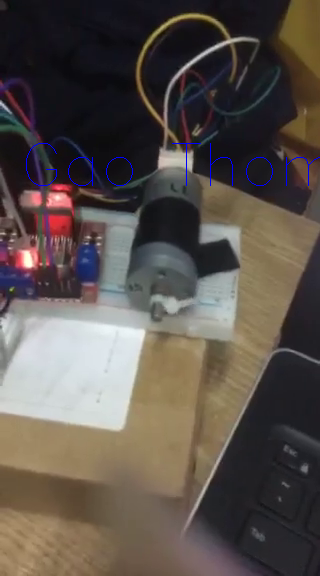

Gao Thom Go Cong
Creating..../data/frame17.jpg


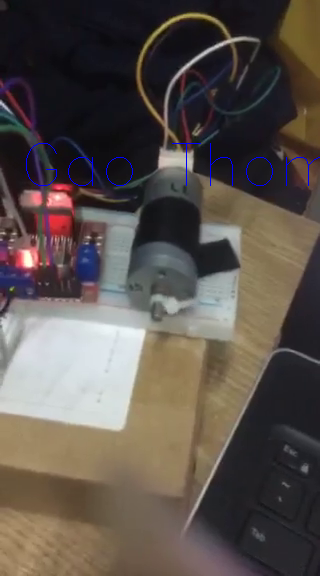

Gao Thom Go Cong
Creating..../data/frame18.jpg


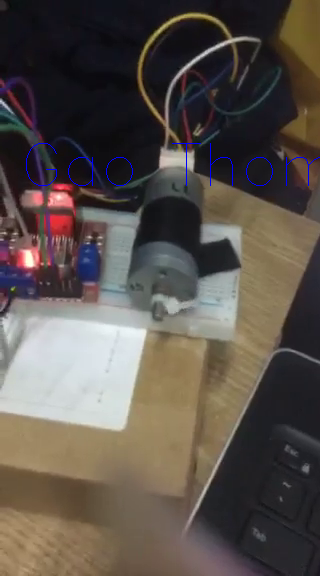

Gao Thom Go Cong
Creating..../data/frame19.jpg


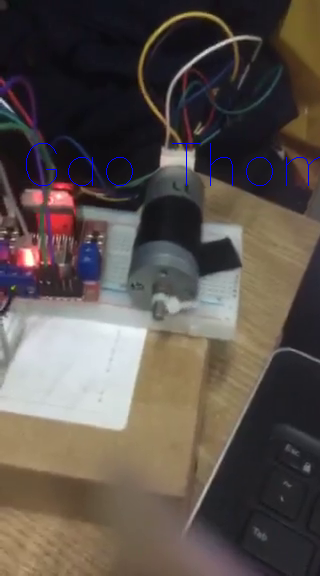

Gao Thom Go Cong
Creating..../data/frame20.jpg


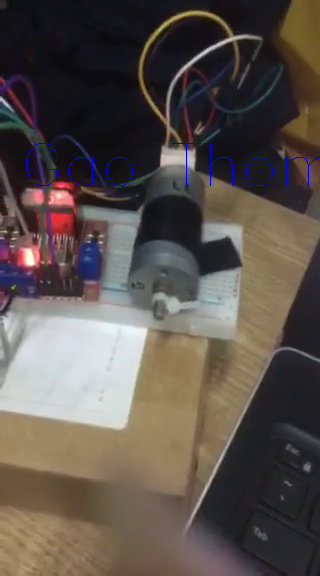

Gao Thom Go Cong
Creating..../data/frame21.jpg


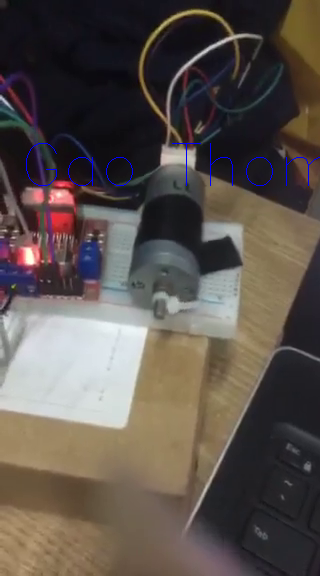

Gao Thom Go Cong
Creating..../data/frame22.jpg


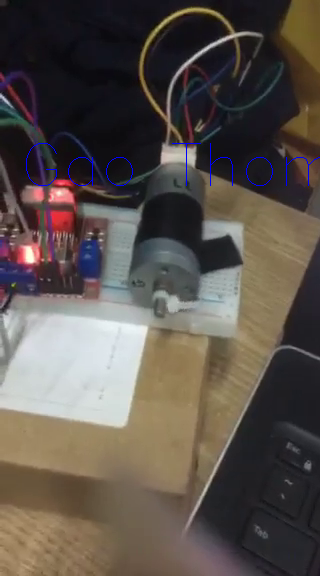

Gao Thom Go Cong
Creating..../data/frame23.jpg


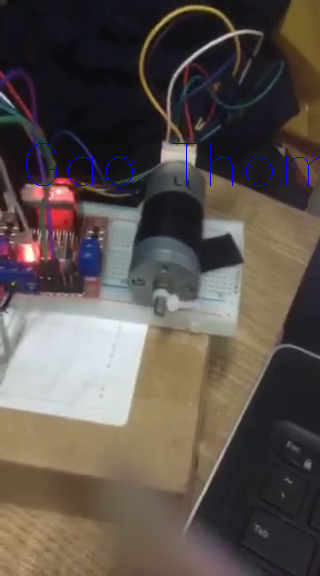

Gao Thom Go Cong
Creating..../data/frame24.jpg


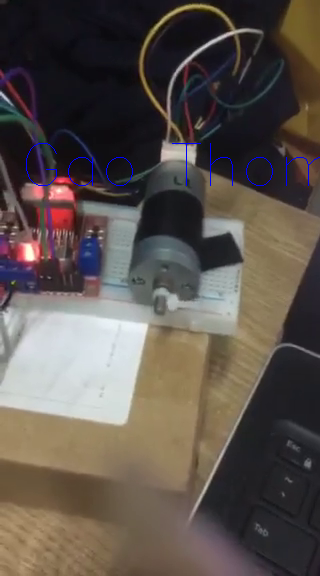

Gao Thom Go Cong
Creating..../data/frame25.jpg


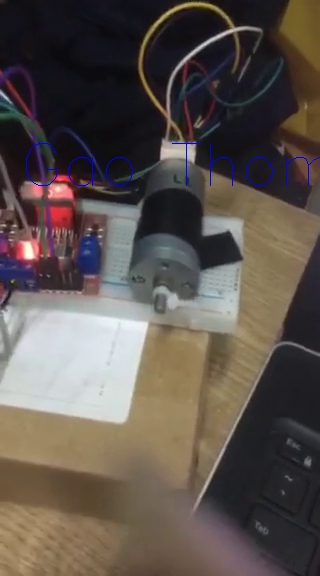

Gao Thom Go Cong
Creating..../data/frame26.jpg


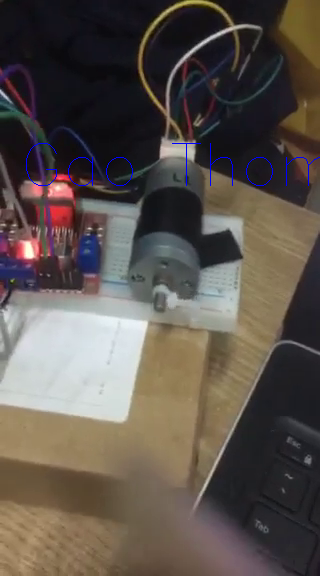

Gao Thom Go Cong
Creating..../data/frame27.jpg


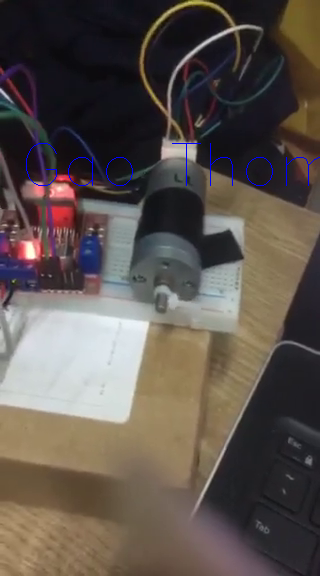

Gao Thom Go Cong
Creating..../data/frame28.jpg


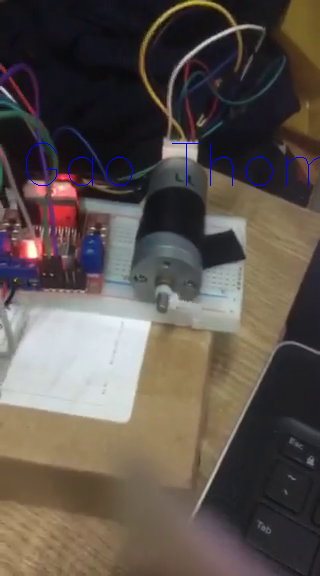

Gao Thom Go Cong
Creating..../data/frame29.jpg


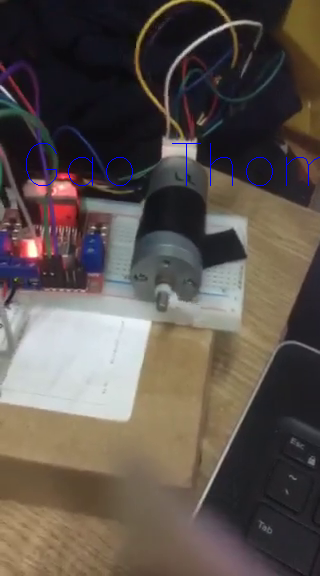

Gao Thom Go Cong
Creating..../data/frame30.jpg


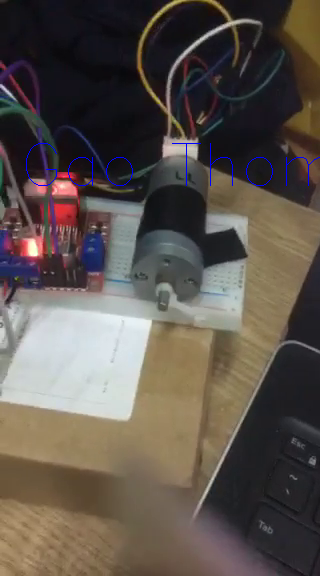

Gao Thom Go Cong
Creating..../data/frame31.jpg


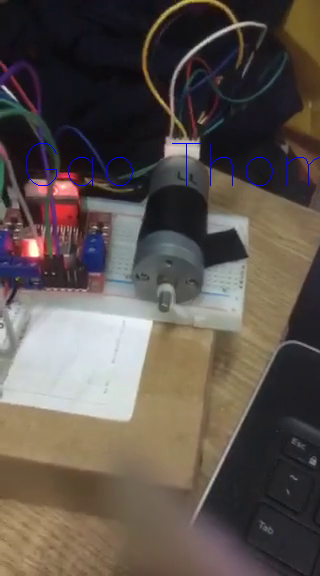

Gao Thom Go Cong
Creating..../data/frame32.jpg


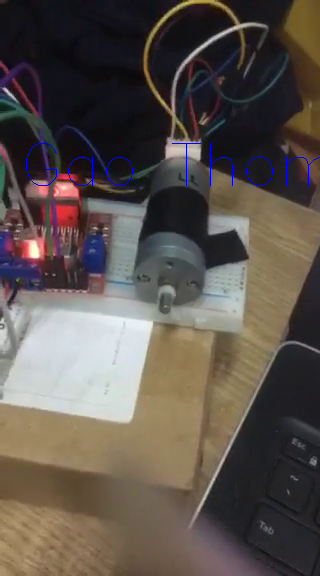

Gao Thom Go Cong
Creating..../data/frame33.jpg


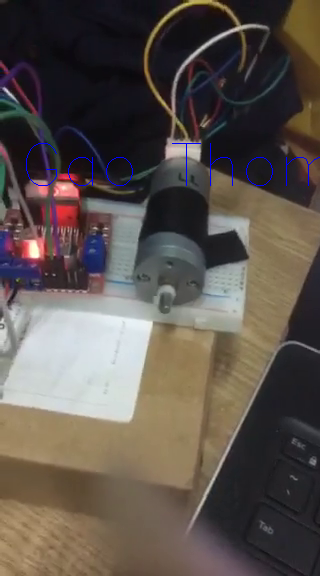

Gao Thom Go Cong
Creating..../data/frame34.jpg


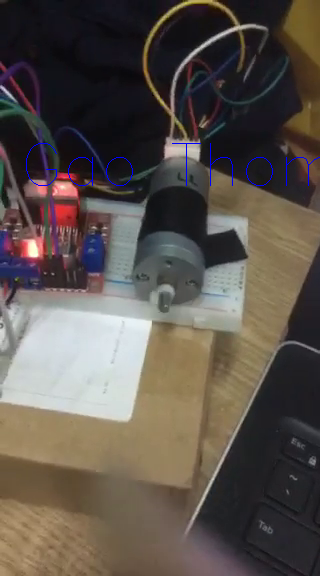

Gao Thom Go Cong
Creating..../data/frame35.jpg


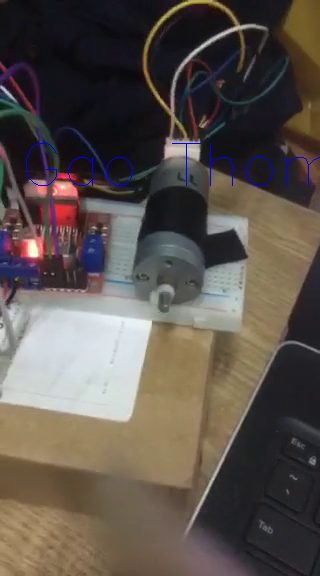

Gao Thom Go Cong
Creating..../data/frame36.jpg


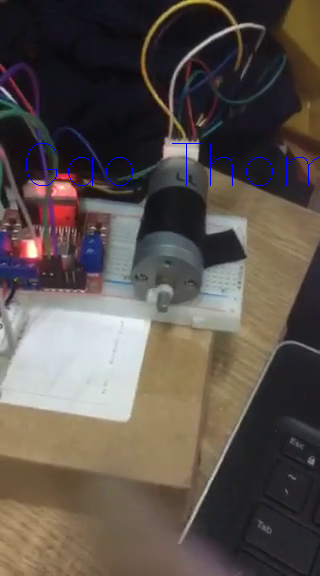

Gao Thom Go Cong
Creating..../data/frame37.jpg


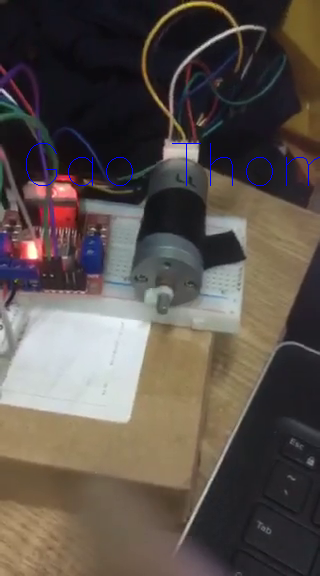

Gao Thom Go Cong
Creating..../data/frame38.jpg


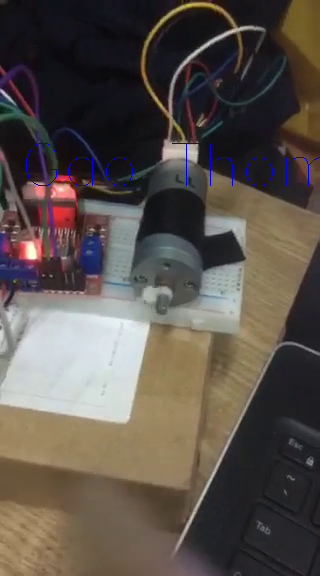

Gao Thom Go Cong
Creating..../data/frame39.jpg


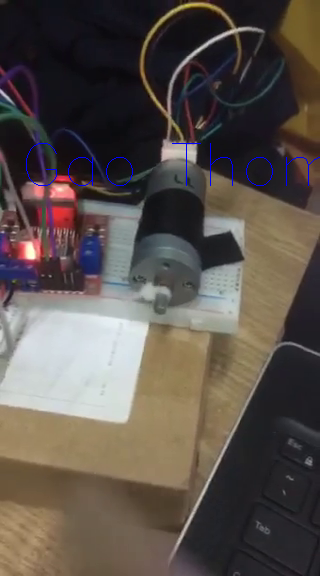

Gao Thom Go Cong
Creating..../data/frame40.jpg


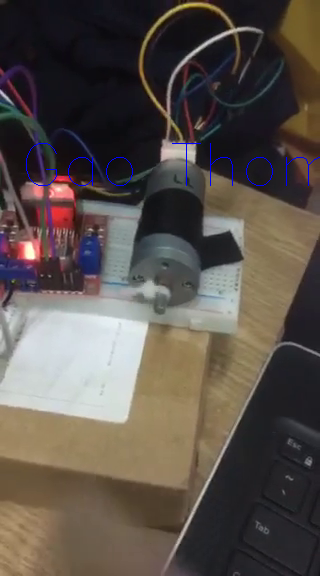

Gao Thom Go Cong
Creating..../data/frame41.jpg


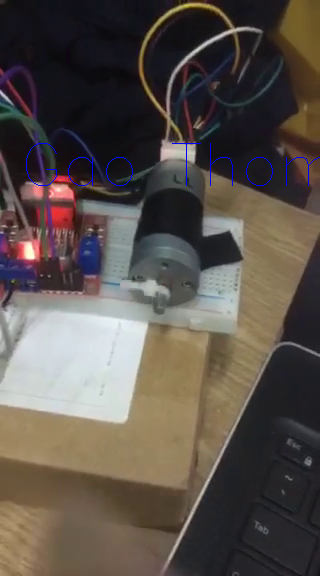

Gao Thom Go Cong
Creating..../data/frame42.jpg


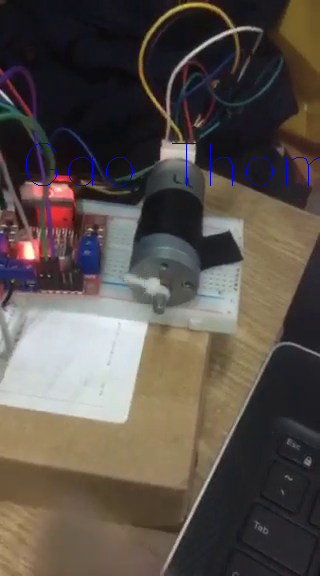

Gao Thom Go Cong
Creating..../data/frame43.jpg


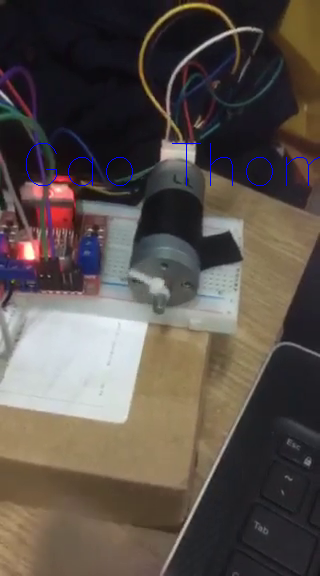

Gao Thom Go Cong
Creating..../data/frame44.jpg


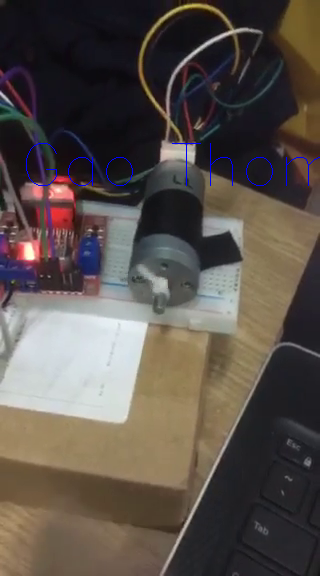

Gao Thom Go Cong
Creating..../data/frame45.jpg


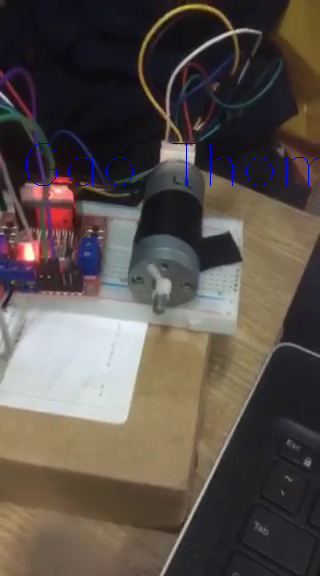

Gao Thom Go Cong
Creating..../data/frame46.jpg


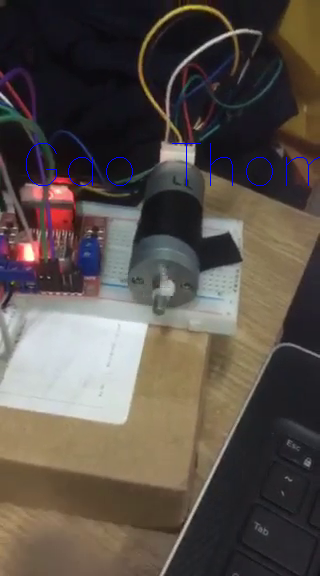

Gao Thom Go Cong
Creating..../data/frame47.jpg


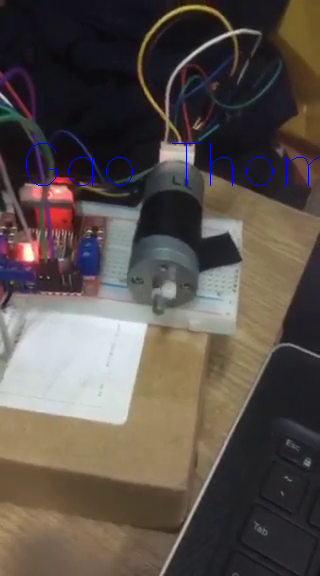

Gao Thom Go Cong
Creating..../data/frame48.jpg


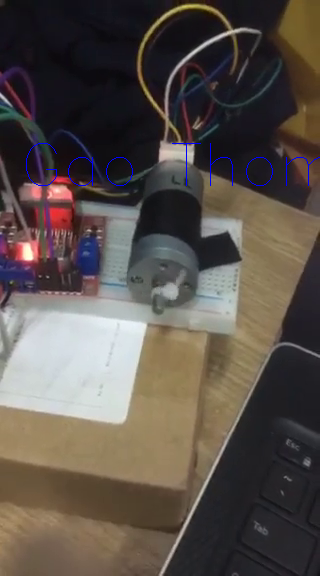

Gao Thom Go Cong
Creating..../data/frame49.jpg


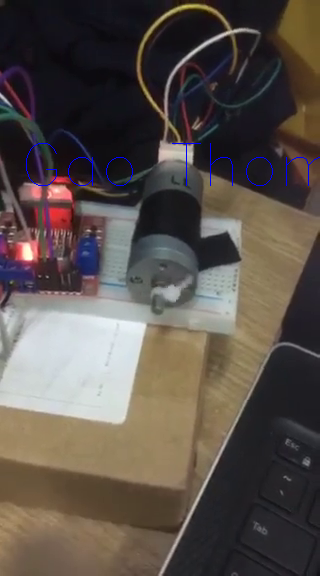

Gao Thom Go Cong
Creating..../data/frame50.jpg


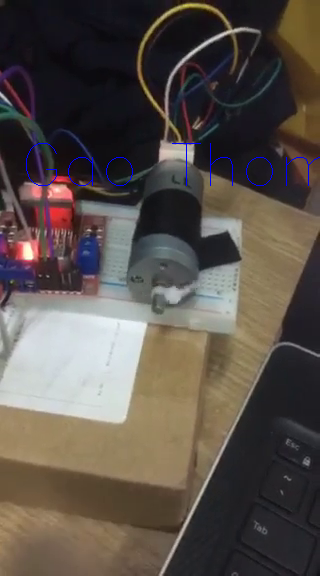

Gao Thom Go Cong
Creating..../data/frame51.jpg


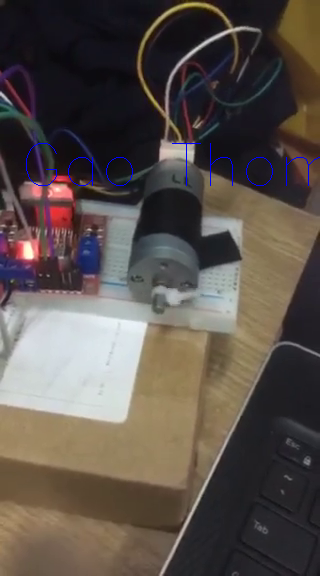

Gao Thom Go Cong
Creating..../data/frame52.jpg


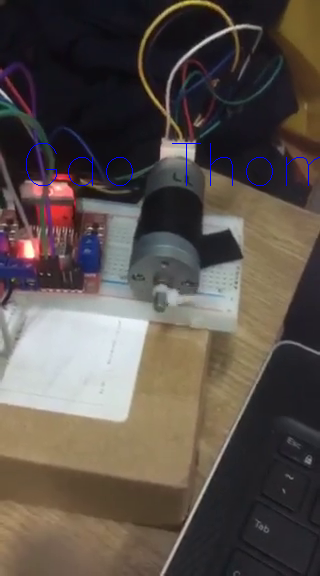

Gao Thom Go Cong
Creating..../data/frame53.jpg


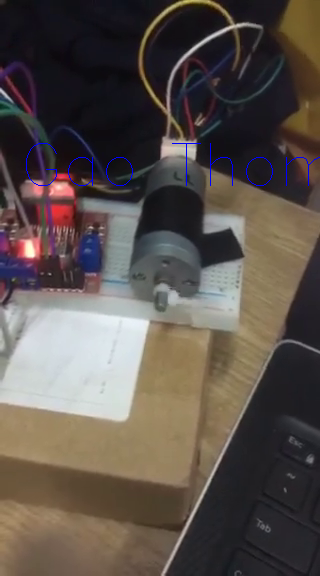

Gao Thom Go Cong
Creating..../data/frame54.jpg


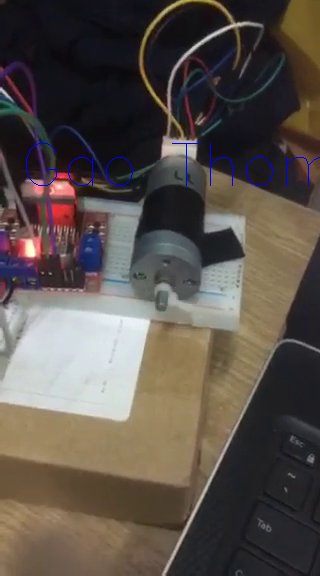

Gao Thom Go Cong
Creating..../data/frame55.jpg


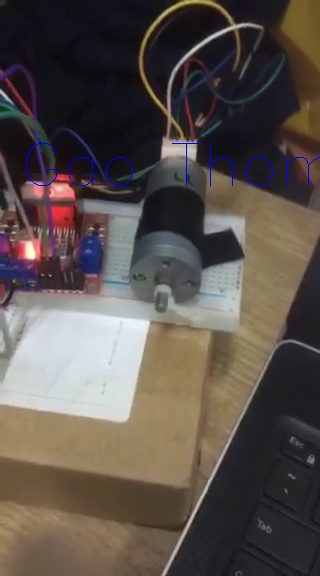

Gao Thom Go Cong
Creating..../data/frame56.jpg


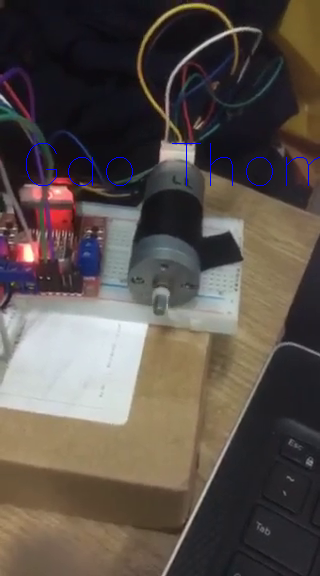

Gao Thom Go Cong
Creating..../data/frame57.jpg


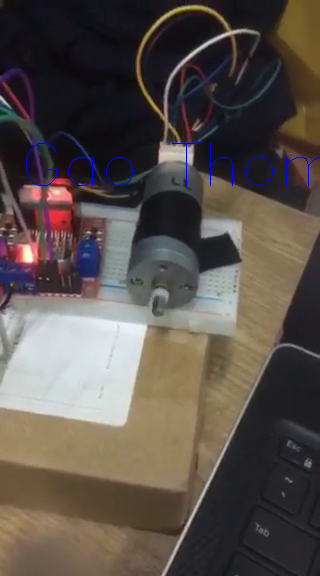

Gao Thom Go Cong
Creating..../data/frame58.jpg


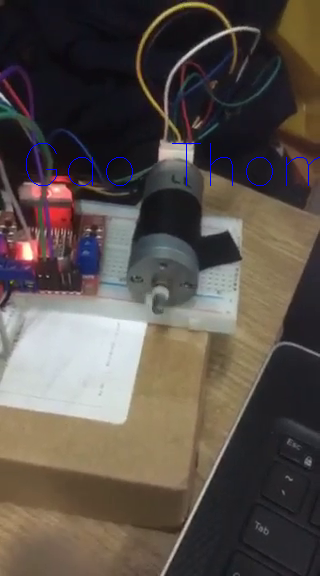

Gao Thom Go Cong
Creating..../data/frame59.jpg


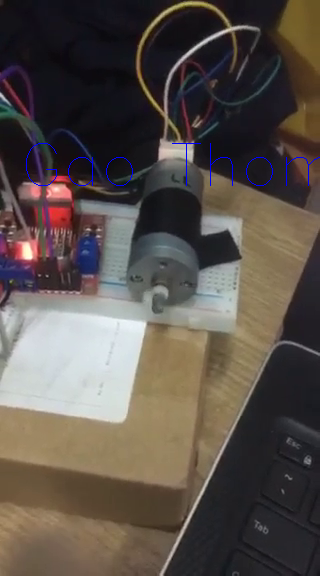

Gao Thom Go Cong
Creating..../data/frame60.jpg


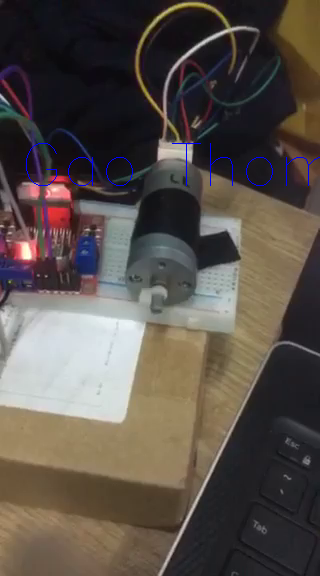

Gao Thom Go Cong
Creating..../data/frame61.jpg


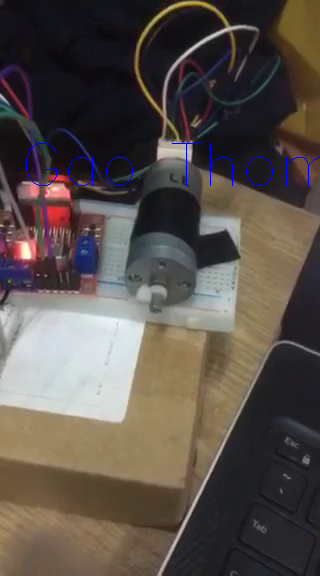

Gao Thom Go Cong
Creating..../data/frame62.jpg


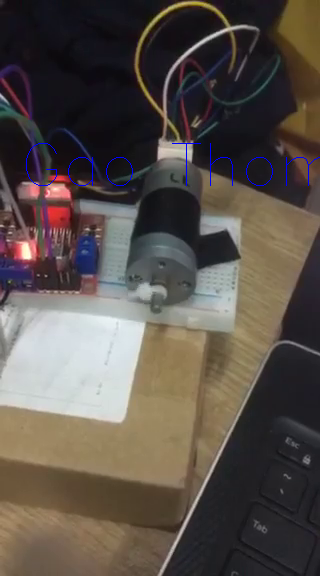

Gao Thom Go Cong
Creating..../data/frame63.jpg


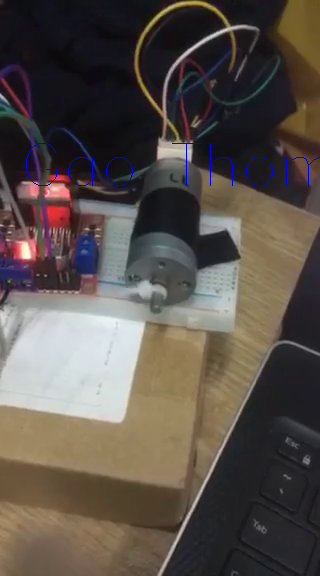

Gao Thom Go Cong
Creating..../data/frame64.jpg


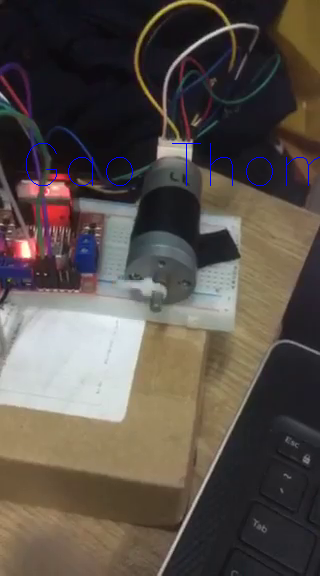

Gao Thom Go Cong
Creating..../data/frame65.jpg


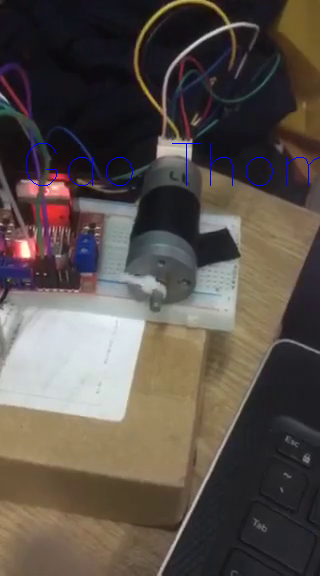

Gao Thom Go Cong
Creating..../data/frame66.jpg


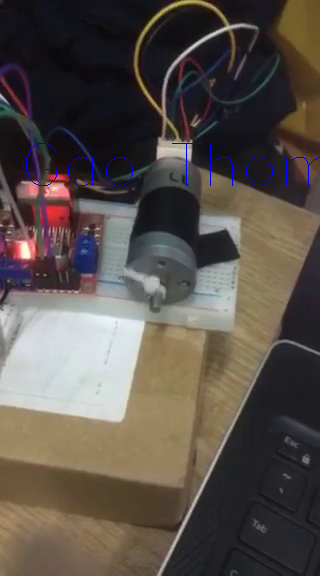

Gao Thom Go Cong
Creating..../data/frame67.jpg


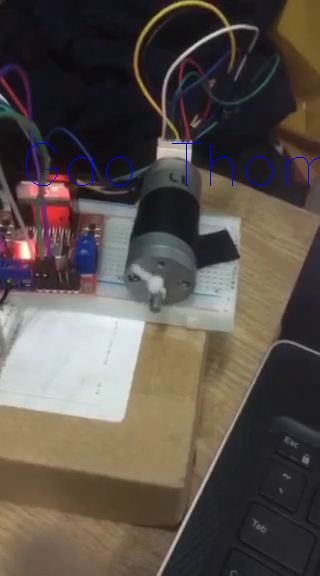

Gao Thom Go Cong
Creating..../data/frame68.jpg


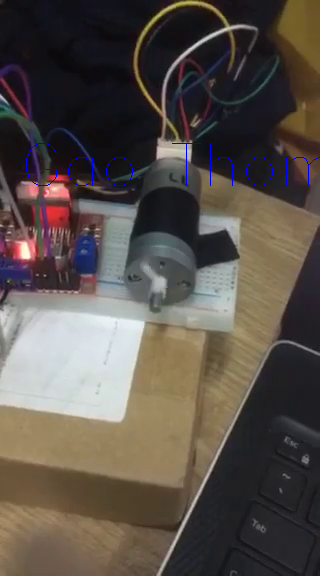

Gao Thom Go Cong
Creating..../data/frame69.jpg


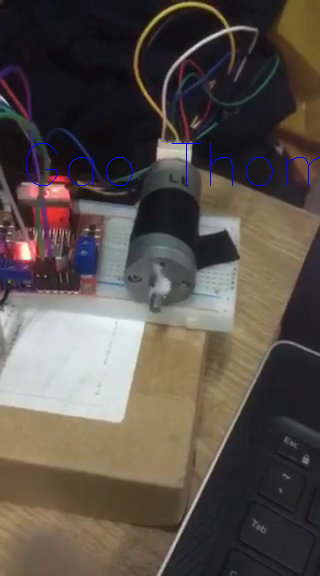

Gao Thom Go Cong
Creating..../data/frame70.jpg


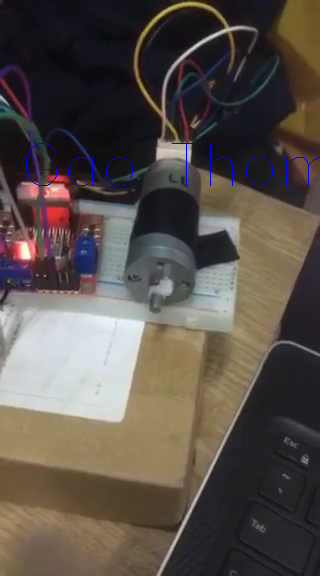

Gao Thom Go Cong
Creating..../data/frame71.jpg


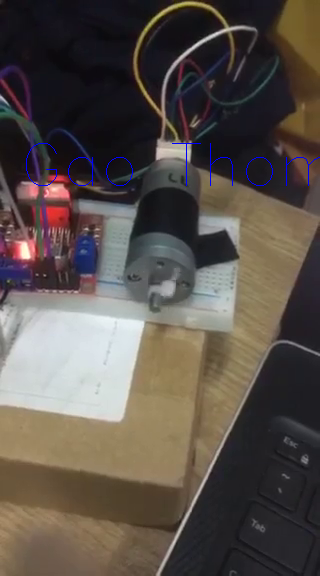

Gao Thom Go Cong
Creating..../data/frame72.jpg


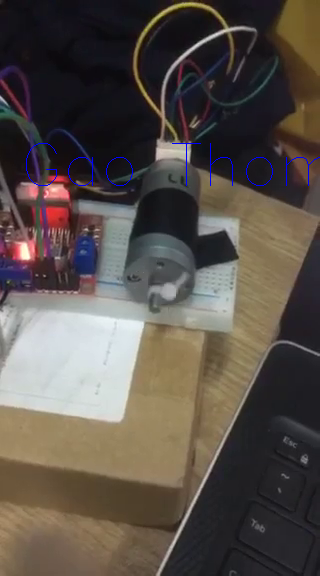

Gao Thom Go Cong
Creating..../data/frame73.jpg


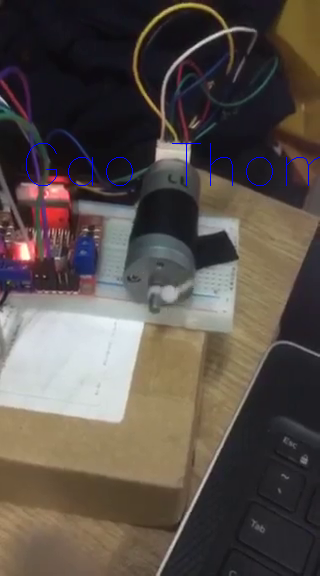

Gao Thom Go Cong
Creating..../data/frame74.jpg


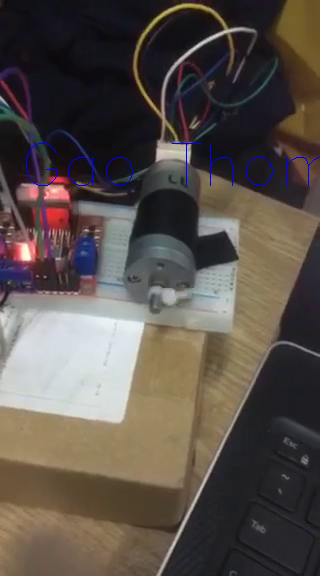

Gao Thom Go Cong
Creating..../data/frame75.jpg


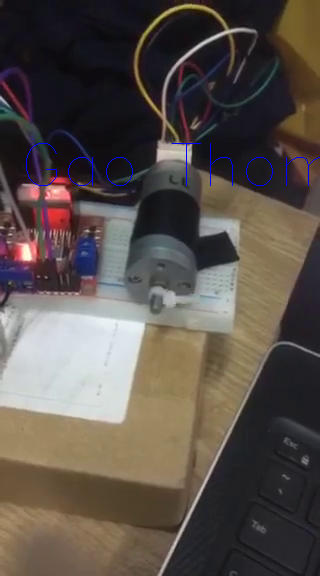

Gao Thom Go Cong
Creating..../data/frame76.jpg


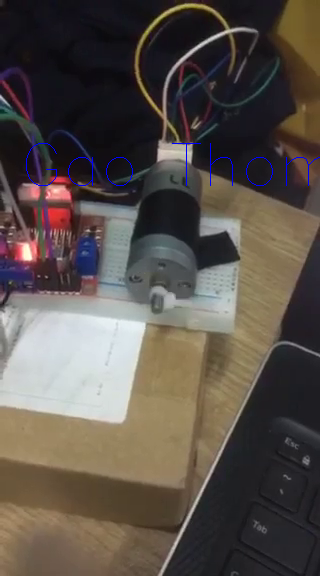

Gao Thom Go Cong
Creating..../data/frame77.jpg


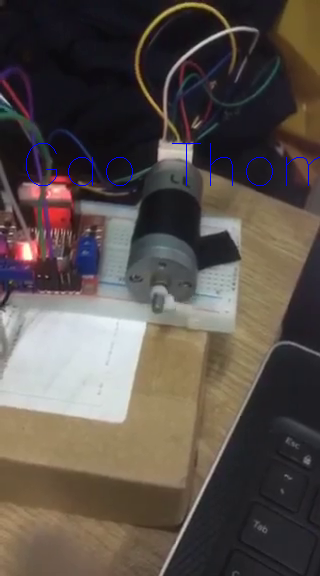

Gao Thom Go Cong
Creating..../data/frame78.jpg


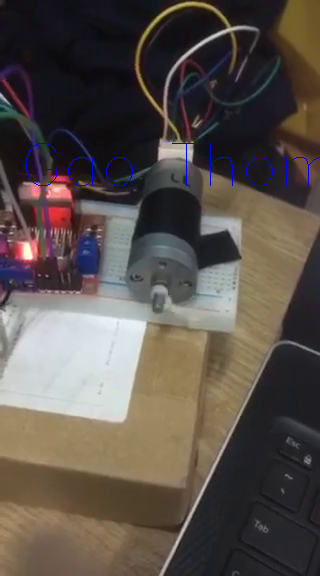

Gao Thom Go Cong
Creating..../data/frame79.jpg


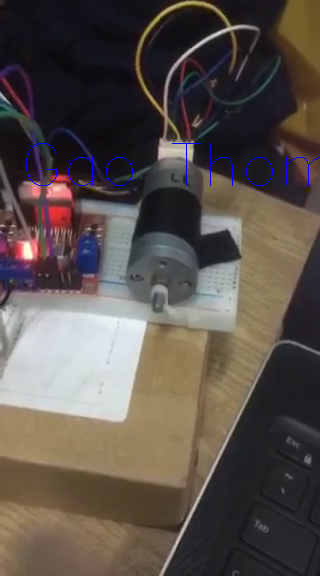

Gao Thom Go Cong
Creating..../data/frame80.jpg


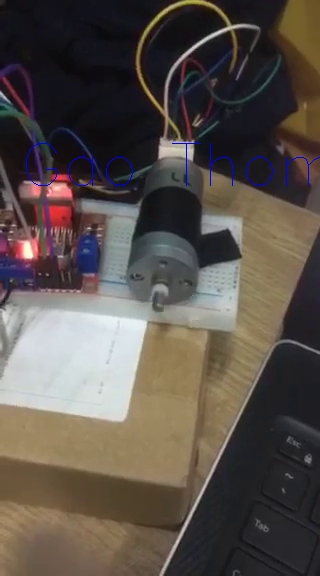

Gao Thom Go Cong
Creating..../data/frame81.jpg


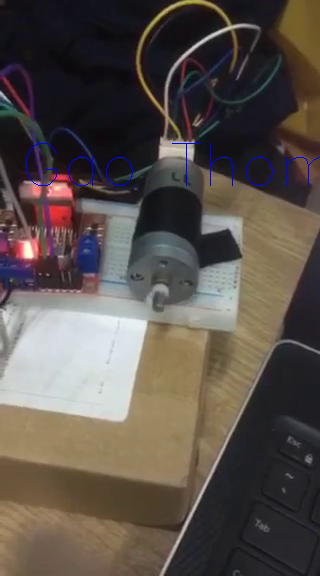

Gao Thom Go Cong
Creating..../data/frame82.jpg


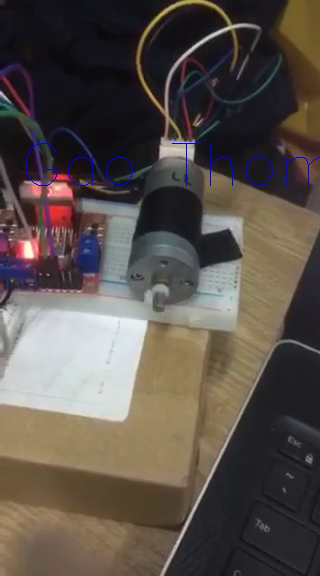

Gao Thom Go Cong
Creating..../data/frame83.jpg


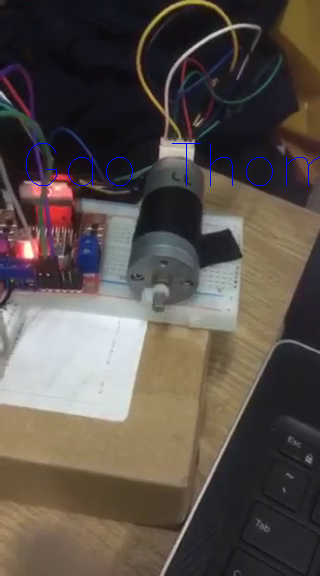

Gao Thom Go Cong
Creating..../data/frame84.jpg


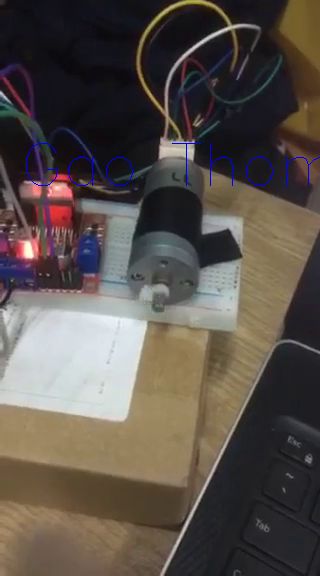

Gao Thom Go Cong
Creating..../data/frame85.jpg


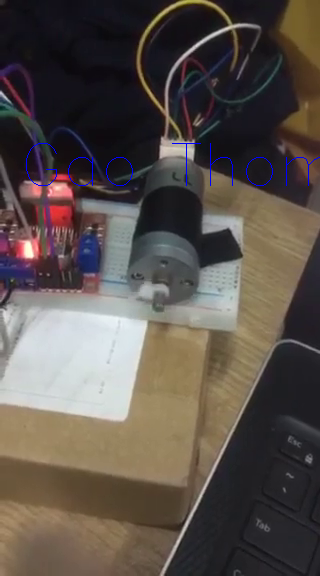

Gao Thom Go Cong
Creating..../data/frame86.jpg


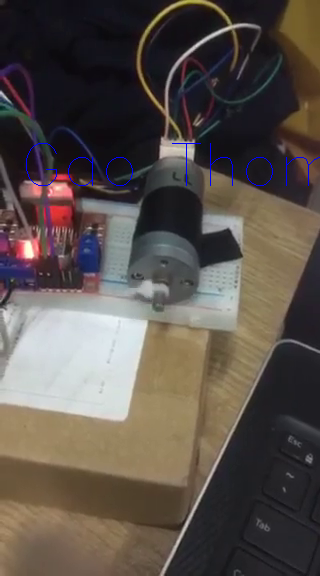

Gao Thom Go Cong
Creating..../data/frame87.jpg


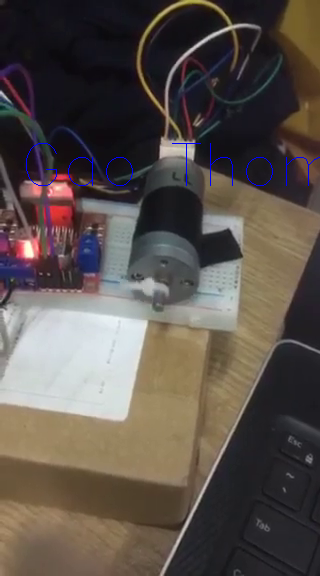

Gao Thom Go Cong
Creating..../data/frame88.jpg


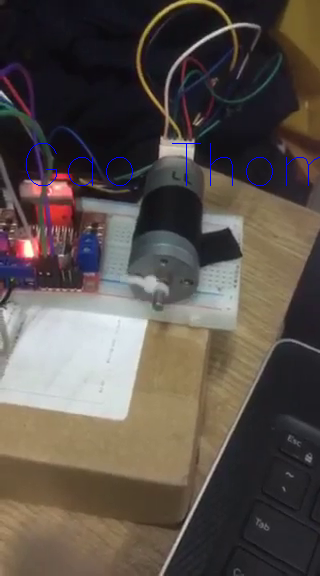

Gao Thom Go Cong
Creating..../data/frame89.jpg


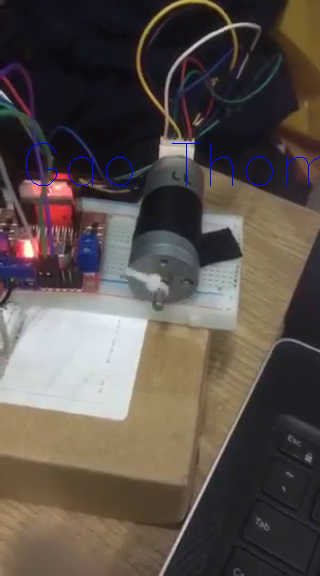

Gao Thom Go Cong
Creating..../data/frame90.jpg


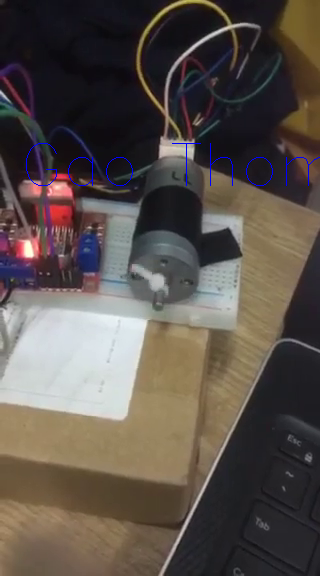

Gao Thom Go Cong
Creating..../data/frame91.jpg


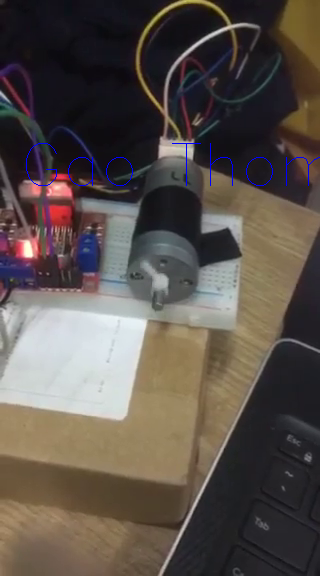

Gao Thom Go Cong
Creating..../data/frame92.jpg


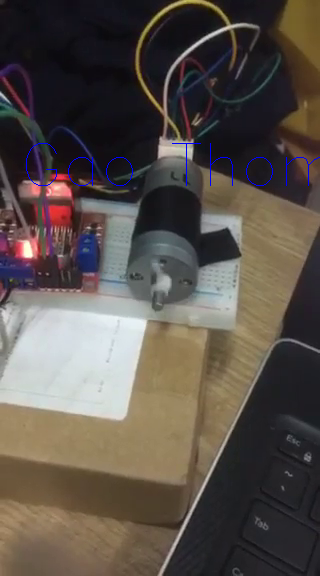

Gao Thom Go Cong
Creating..../data/frame93.jpg


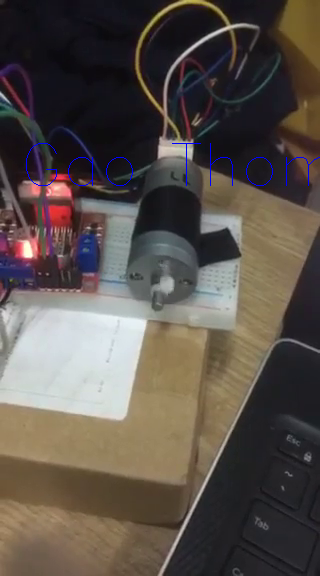

Gao Thom Go Cong
Creating..../data/frame94.jpg


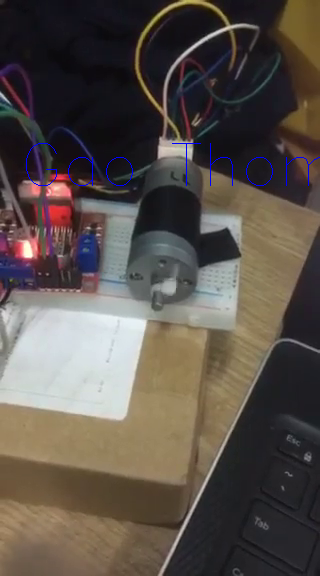

Gao Thom Go Cong
Creating..../data/frame95.jpg


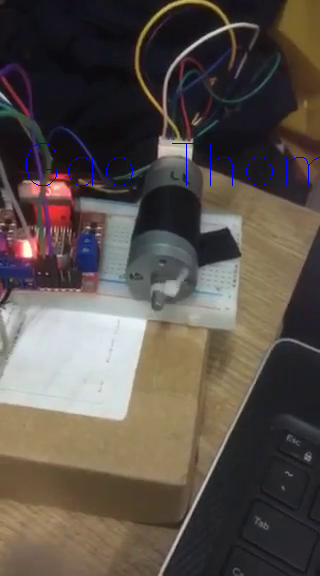

Gao Thom Go Cong
Creating..../data/frame96.jpg


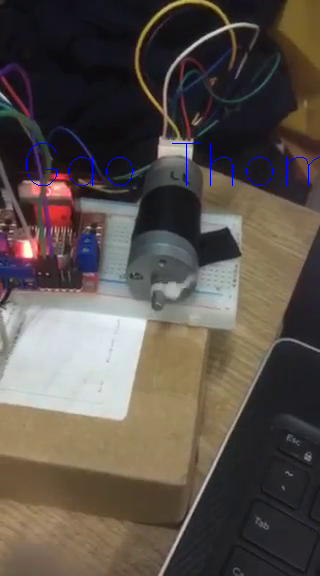

Gao Thom Go Cong
Creating..../data/frame97.jpg


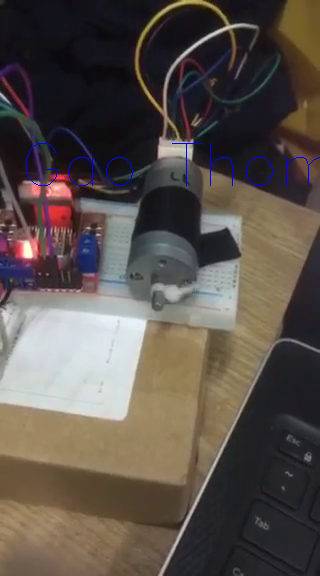

Gao Thom Go Cong
Creating..../data/frame98.jpg


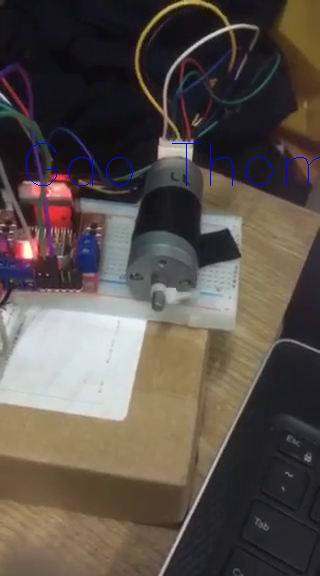

Gao Thom Go Cong
Creating..../data/frame99.jpg


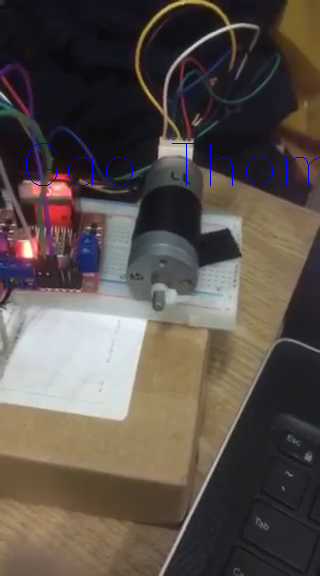

Gao Thom Go Cong
Creating..../data/frame100.jpg


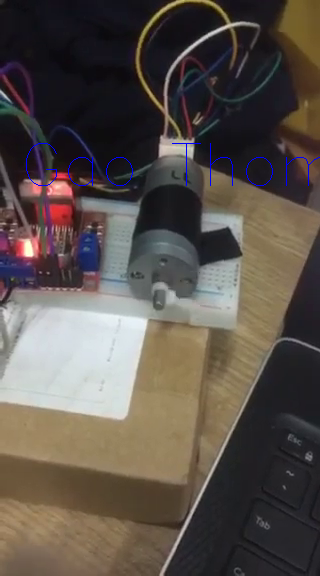

Gao Thom Go Cong
Creating..../data/frame101.jpg


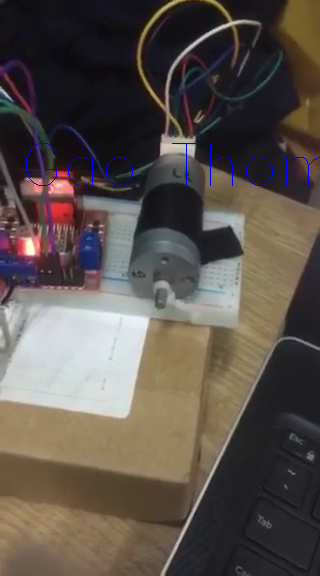

Gao Thom Go Cong
Creating..../data/frame102.jpg


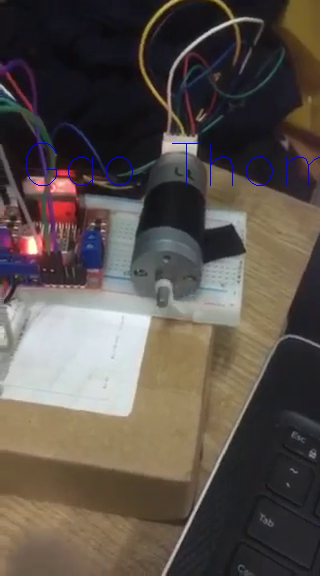

Gao Thom Go Cong


In [ ]:
# Camera
import cv2
import numpy as np
from imutils.video import VideoStream
from tensorflow.keras.models import load_model
import os
from tensorflow.keras.utils import load_img, img_to_array
from google.colab.patches import cv2_imshow

os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'

model = load_model('rice.h5')
# Create a VideoCapture object and read from input file
cap = cv2.VideoCapture('/content/video-1655738660.mp4')

try:
    # creating a folder named data
    if not os.path.exists('data'):
        os.makedirs('data')

# if not created then raise error
except OSError:
    print ('Error: Creating directory of data')


# frame
currentframe = 0


# Check if camera opened successfully
if (cap.isOpened()== False):
    print("Error opening video file")

# Read until video is completed
while(cap.isOpened()):

# Capture frame-by-frame
    ret, frame = cap.read()
    if ret == True:


	# Display the resulting frame
        

        # if video is still left continue creating images
        name = './data/frame' + str(currentframe) + '.jpg'
        print ('Creating...' + name)

        # writing the extracted images
        cv2.imwrite(name, frame)
        filename = name

        predict = ['Gao lut',
                   'Gao Huyet Rong',
                   'Gao Lai Sua',
                   'Gao Long Lai',
                   'Gao Lut Bac',
                   'Gao lut Dien Bien',
                   ' Gao Lut Do',
                   'Gao Lut Trang',
                   'Gao Nep Cam',
                   'Gao Nep Sap',
                   'Gao Ngoc Troi',
                   'Gao Tam',
                   'Gao Tam Thom',
                   'gao Thom Go Cong'
                   'Gao Thom My',
                   'None']
        predict = np.array(predict)
        img = load_img(filename,target_size=(250,250))

        img = load_img(filename,target_size=(250,250))
        img = img_to_array(img)
        img = img.reshape(1,250,250,3)
        img = img.astype('float32')
        img = img/255

        result = np.argmax(model.predict(img),axis=-1)
        predict[result]

        if(result==0):
            a = "Gao Lut"
        if(result==1):
            a = "Gao Huyet Rong"
        if(result==2):
            a = "Gao Lai Sua"
        if(result==3):
            a = "Gao Long Lai"           
        if(result==4):
            a = "Gao Lut Bac"
        if(result==5):
            a = "Gao Lut Dien Bien"
        if(result==6):
            a = "Gao Lut Do"
        if(result==7):
            a = "Gao Lut Trang"
        if(result==8):
            a = "Gao Nep Cam"
        if(result==9):
            a = "Gao Nep Sap"
        if(result==10):
            a = "Gao Ngoc Troi"
        if(result==11):
            a = "Gao Tam "
        if(result==12):
            a = "Gao Tam Thom "
        if(result==13):
            a = "Gao Thom Go Cong"
        if(result==14):
            a = "Gao Thom My"      
        if(result==15):
            a = "Khong co gao"          
        # org
        org = (20, 185)
        
        # fontScale
        fontScale = 2
        
        # Blue color in BGR
        color = (255, 0, 0)
        font = cv2.FONT_HERSHEY_SIMPLEX
        # Line thickness of 2 px
        thickness = 2
        cv2.putText(frame,a,org,font,fontScale,color,1)
        cv2_imshow( frame)
        print(a)
        # increasing counter so that it will
        # show how many frames are created
        currentframe += 1

	# Press Q on keyboard to exit
        if cv2.waitKey(25) & 0xFF == ord('q'):
            break

# Break the loop
    else:
	    break

# When everything done, release
# the video capture object
cap.release()

# Closes all the frames
cv2.destroyAllWindows()